In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Layer
from tensorflow.keras.layers import (
    Reshape, Conv2DTranspose, Add, Conv2D, MaxPool2D, Dense,
    Flatten, InputLayer, BatchNormalization, Input, LeakyReLU,
)
from tensorflow.keras.optimizers import Adam
import os
import shutil

In [ ]:
ROOT_DIR = "/content/drive/MyDrive/tfds_data/celeba-dataset/"

from google.colab import drive

drive.mount('/content/drive')
os.makedirs(ROOT_DIR, exist_ok=True)

Mounted at /content/drive


In [ ]:
# !pip install -q kaggle
# !mkdir ~/.kaggle/
# !cp kaggle.json ~/.kaggle/
# !chmod 600 /root/.kaggle/kaggle.json
# !kaggle datasets download -d jessicali9530/celeba-dataset
# !unzip "/content/celeba-dataset.zip" -d {ROOT_DIR}

In [ ]:
BATCH_SIZE = 128
LATENT_DIM = 100
IM_SHAPE = (64,64,3)
EPOCHS = 20
LR = 2e-4

In [ ]:
# # Creating a reduced dataset
# source_dir = ROOT_DIR + "img_align_celeba/img_align_celeba/"
# destination_dir = ROOT_DIR + "img_align_celeba/img_align_celeba_v2/"

# os.makedirs(destination_dir, exist_ok=True)
# # files = os.listdir(source_dir)
# files = os.listdir(source_dir)[:1000]
# files_to_copy = files[:1000]
# # files_to_copy = files[:4000]
# k = 0
# for file_name in files_to_copy:
#     src_file = os.path.join(source_dir, file_name)
#     dest_file = os.path.join(destination_dir, file_name)
#     if os.path.isfile(src_file):
#         shutil.copy(src_file, dest_file)
#         # print(f"{k+1} - Copied {file_name} to {destination_dir}")
#         print(k, end="\r", flush=True)
#         k+=1

In [ ]:
# https://github.com/Neuralearn/deep-learning-with-tensorflow-2/blob/main/deep%20learning%20for%20computer%20vision/9-DCGAN%20By%20Neuralearn.ai-.ipynb
dataset = tf.keras.preprocessing.image_dataset_from_directory(
    # ROOT_DIR+"img_align_celeba/img_align_celeba/",
    ROOT_DIR+"img_align_celeba/img_align_celeba_v2/",
    label_mode=None,
    image_size=(IM_SHAPE[0], IM_SHAPE[1]),
    batch_size=BATCH_SIZE,
)

Found 1000 files.


In [ ]:
def preprocess(image):
  # We want the image pixels to be between -1 and 1.
  return tf.cast(image, dtype=tf.float32) / 127.5 - 1

train_dataset = (
    dataset
    .map(preprocess)
    .unbatch() # -> Beware with this thing.
    .shuffle(buffer_size=8, reshuffle_each_iteration=True)
    # drop_remainder is used for those annoying cases when the number of
    # elements is not divisible by the batch size.
    .batch(BATCH_SIZE, drop_remainder=True)
    .prefetch(tf.data.AUTOTUNE)
)

for d in train_dataset.take(1):
  print(d.shape)

(128, 64, 64, 3)


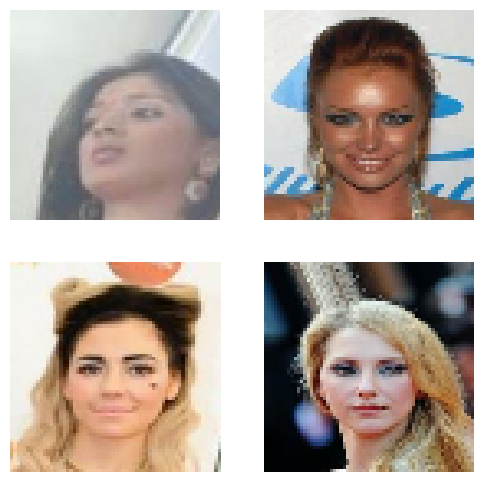

In [ ]:
plt.figure(figsize=[6,6])

k=0
for img in train_dataset.unbatch().take(4):
  plt.subplot(2, 2, k+1)
  plt.imshow((img+1)/2)
  # plt.imshow(img)
  plt.axis("off")
  k+=1

plt.show()

In [ ]:
generator = tf.keras.Sequential([
    Input(shape=(LATENT_DIM,)),
    Dense(4*4*LATENT_DIM),
    Reshape((4,4,LATENT_DIM)),

    Conv2DTranspose(512, kernel_size=4, strides=2, padding="same"),
    BatchNormalization(),
    LeakyReLU(0.2),

    Conv2DTranspose(256, kernel_size=4, strides=2, padding="same"),
    BatchNormalization(),
    LeakyReLU(0.2),

    Conv2DTranspose(128, kernel_size=4, strides=2, padding="same"),
    BatchNormalization(),
    LeakyReLU(0.2),

    # 3 is the size channel in the shape (64,64,3)
    Conv2DTranspose(3, kernel_size=4, strides=2, padding="same", activation=tf.keras.activations.tanh),
], name="generator")
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 1600)                │         161,600 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 4, 4, 100)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 8, 8, 512)           │         819,712 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 8, 8, 512)           │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 16, 16, 256)         │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 16, 16, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_2 (Conv2DTranspose) │ (None, 32, 32, 128)         │         524,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 32, 32, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_3 (Conv2DTranspose) │ (None, 64, 64, 3)           │           6,147 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,612,867 (13.78 MB)

 Trainable params: 3,611,075 (13.78 MB)

 Non-trainable params: 1,792 (7.00 KB)

In [ ]:
discriminator = tf.keras.Sequential([
    Input(shape=(IM_SHAPE[0], IM_SHAPE[1], 3)),

    Conv2D(64, kernel_size=4, strides=2, padding="same"),
    LeakyReLU(0.2),

    Conv2D(128, kernel_size=4, strides=2, padding="same"),
    BatchNormalization(),
    LeakyReLU(0.2),

    Conv2D(256, kernel_size=4, strides=2, padding="same"),
    BatchNormalization(),
    LeakyReLU(0.2),

    Conv2D(1, kernel_size=4, strides=2, padding="same"),
    Flatten(),

    Dense(1, activation="sigmoid"),
], name="discriminator")
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)                    │ (None, 32, 32, 64)          │           3,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_6 (LeakyReLU)            │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 16, 16, 128)         │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_5                │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_7 (LeakyReLU)            │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_6 (Conv2D)                    │ (None, 8, 8, 256)           │         524,544 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_6                │ (None, 8, 8, 256)           │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_8 (LeakyReLU)            │ (None, 8, 8, 256)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 4, 4, 1)             │           4,097 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 16)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 1)                   │              17 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 664,530 (2.53 MB)

 Trainable params: 663,762 (2.53 MB)

 Non-trainable params: 768 (3.00 KB)

In [ ]:
class ShowImage(tf.keras.callbacks.Callback):
  def __init__(self, latent_dim=100):
    super().__init__()
    self.latent_dim = 100
    os.makedirs("generated", exist_ok=True)

  def on_epoch_end(self, epoch, logs=None):
    n=6
    k=0
    random_noise = tf.random.normal(shape=(36, self.latent_dim))
    # self.model is the model where this callback has been placed into.
    generated = self.model.generator(random_noise)
    # print(generated.shape)

    plt.figure(figsize=[16,16])
    for i in range(n):
      for j in range(n):
        plt.subplot(n, n, k+1)
        plt.imshow((generated[k]+1)/2) # Unormalizing
        plt.axis("off")
        k+=1
    plt.savefig(f"generated/gen_images_epoch_{epoch}.png")

# Deep Convolutional Generative Adversarial Network
class DCGAN(Model):
  def __init__(self, generator, discriminator):
    super().__init__()
    self.generator = generator
    self.discriminator = discriminator

  def compile(self, g_optimizer, d_optimizer, loss_fn):
    super().compile()
    self.g_optimizer = g_optimizer
    self.d_optimizer = d_optimizer
    self.loss_fn = loss_fn
    # m -> metric
    # self.g_loss_m = tf.keras.metrics.Mean()
    self.g_loss_metric = tf.keras.metrics.Mean()
    self.d_loss_metric = tf.keras.metrics.Mean()

  @property
  def metrics(self):
    return [self.g_loss_metric, self.d_loss_metric]

  def train_step(self, real_images):
    batch_size = tf.shape(real_images)[0]

    # ========== Discriminator ==========
    random_noise = tf.random.normal(shape=(batch_size, LATENT_DIM))
    generated_images = generator(random_noise)
    """
    labels:
    >> 1 for real images
    >> 0 for fake/generated images
    """
    # Adding random chances for real_labels being in the interval [0.75, 1.25]
    real_labels = tf.ones((batch_size, 1)) + 0.25 * tf.random.uniform((batch_size, 1), minval=-1, maxval=1)
    # Adding random chances for generated_labels being in the interval [0, 0.25]
    generated_labels = tf.zeros((batch_size, 1)) + 0.25 * tf.random.uniform((batch_size, 1), minval=0, maxval=1)

    with tf.GradientTape() as tape:
      # preds -> predictions
      real_preds = self.discriminator(real_images)
      d_loss_real = self.loss_fn(real_labels, real_preds)

      generated_preds = self.discriminator(generated_images)
      d_loss_generated = self.loss_fn(generated_labels, generated_preds)

      d_loss = d_loss_real + d_loss_generated

    partial_derivatives = tape.gradient(d_loss, self.discriminator.trainable_weights)
    self.d_optimizer.apply_gradients(zip(partial_derivatives, self.discriminator.trainable_weights))

    # ========== Generator ==========
    random_noise = tf.random.normal(shape=(batch_size, LATENT_DIM))

    # NOTE: 'flipped' because we want the generator to fool the discriminator.
    # Adding random chances for flipped_generated_labels being in the interval [0, 0.25]
    flipped_generated_labels = tf.ones((batch_size, 1)) + 0.25 * tf.random.uniform((batch_size, 1), minval=-1, maxval=1)

    with tf.GradientTape() as tape:
      generated_images = self.generator(random_noise) # This needs to be inside the scope of the tape.
      generated_preds = self.discriminator(generated_images)
      g_loss = self.loss_fn(flipped_generated_labels, generated_preds)

    partial_derivatives = tape.gradient(g_loss, self.generator.trainable_weights)
    self.g_optimizer.apply_gradients(zip(partial_derivatives, self.generator.trainable_weights))

    self.d_loss_metric.update_state(d_loss)
    self.g_loss_metric.update_state(g_loss)

    return {"g_loss":self.g_loss_metric.result(), "d_loss":self.d_loss_metric.result()}

In [ ]:
dcgan = DCGAN(generator, discriminator)
"""
>> Adam is an adaptive optimizer that adjusts the learning rate for each parameter
based on the first and second moments (mean and variance) of the gradients. It
uses two parameters, beta_1 and beta_2, to control the decay rates of these moments.
>> beta_1: beta_1 parameter is a hyperparameter that controls the exponential
decay rate for the first moment estimate (i.e., the moving average of the gradients).
>> beta_1: This is the exponential decay rate for the moving average of the
first moment (the gradient itself). It determines how much weight is given to
past gradients versus the current gradient when updating the moving average.
* A high beta_1 (e.g., 0.9) means the optimizer "remembers" more past gradients,
and the moving average changes more slowly.
* A lower beta_1 means the optimizer will react more quickly to recent gradients,
making the first moment estimate more sensitive to the current gradient.
"""
dcgan.compile(
    d_optimizer = tf.keras.optimizers.Adam(learning_rate=LR, beta_1=0.5),
    g_optimizer = tf.keras.optimizers.Adam(learning_rate=LR, beta_1=0.5),
    loss_fn = tf.keras.losses.BinaryCrossentropy(),
)

Epoch 1/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 103s 15s/step - d_loss: 0.8454 - g_loss: 1.4931
Epoch 2/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 100s 14s/step - d_loss: 1.0033 - g_loss: 1.2262
Epoch 3/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 101s 14s/step - d_loss: 1.0969 - g_loss: 1.3110
Epoch 4/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 100s 14s/step - d_loss: 1.0292 - g_loss: 1.1739
Epoch 5/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 101s 14s/step - d_loss: 1.0306 - g_loss: 1.3346
Epoch 6/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 141s 14s/step - d_loss: 1.0644 - g_loss: 1.3766
Epoch 7/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 143s 14s/step - d_loss: 1.1704 - g_loss: 1.2518
Epoch 8/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 140s 14s/step - d_loss: 0.9420 - g_loss: 1.6970
Epoch 9/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 145s 15s/step - d_loss: 1.0680 - g_loss: 1.4543
Epoch 10/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 100s 14s/step - d_loss: 1.1626 - g_loss: 1.1698


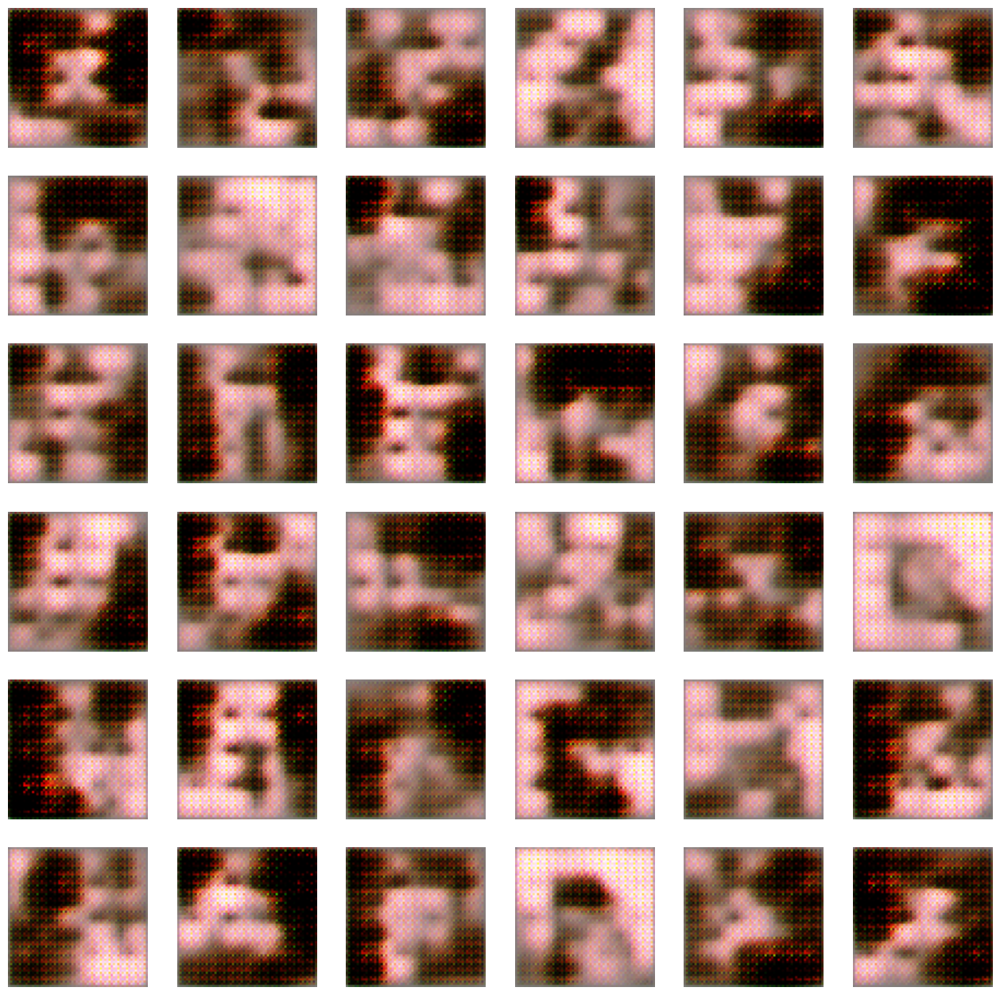

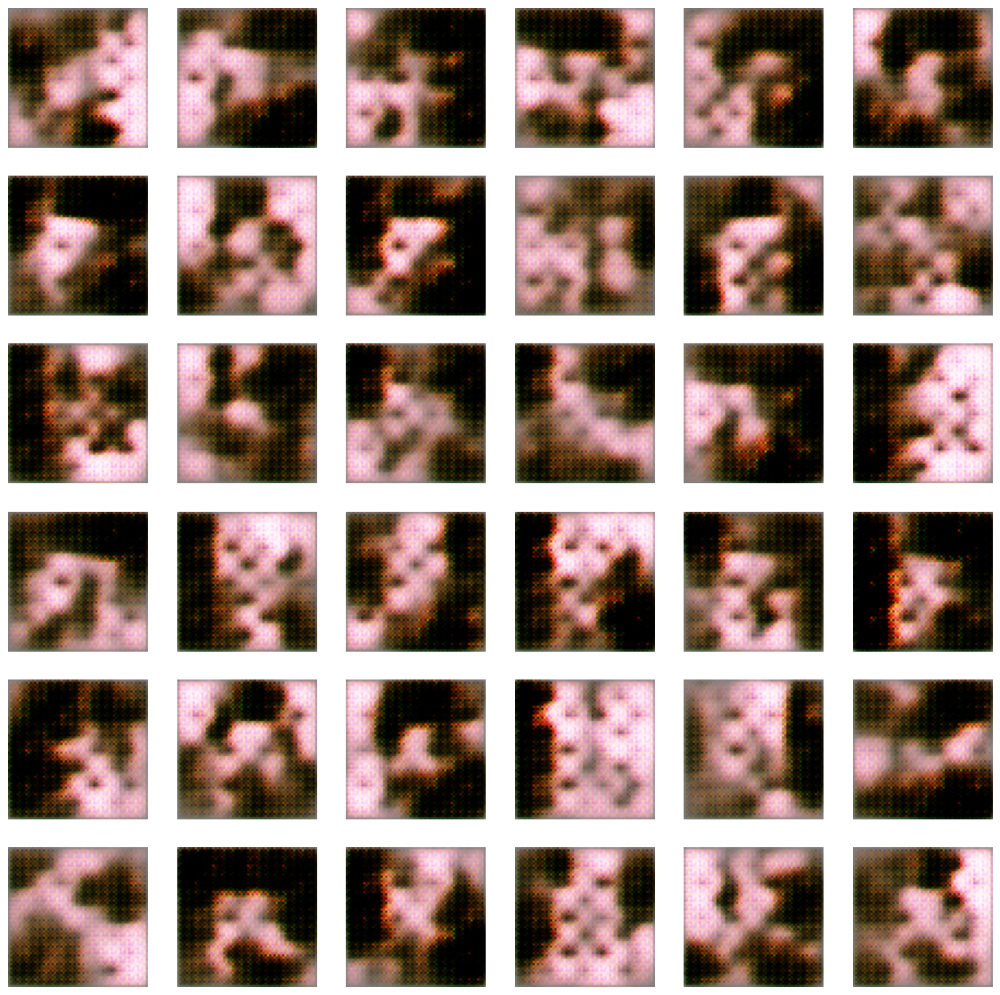

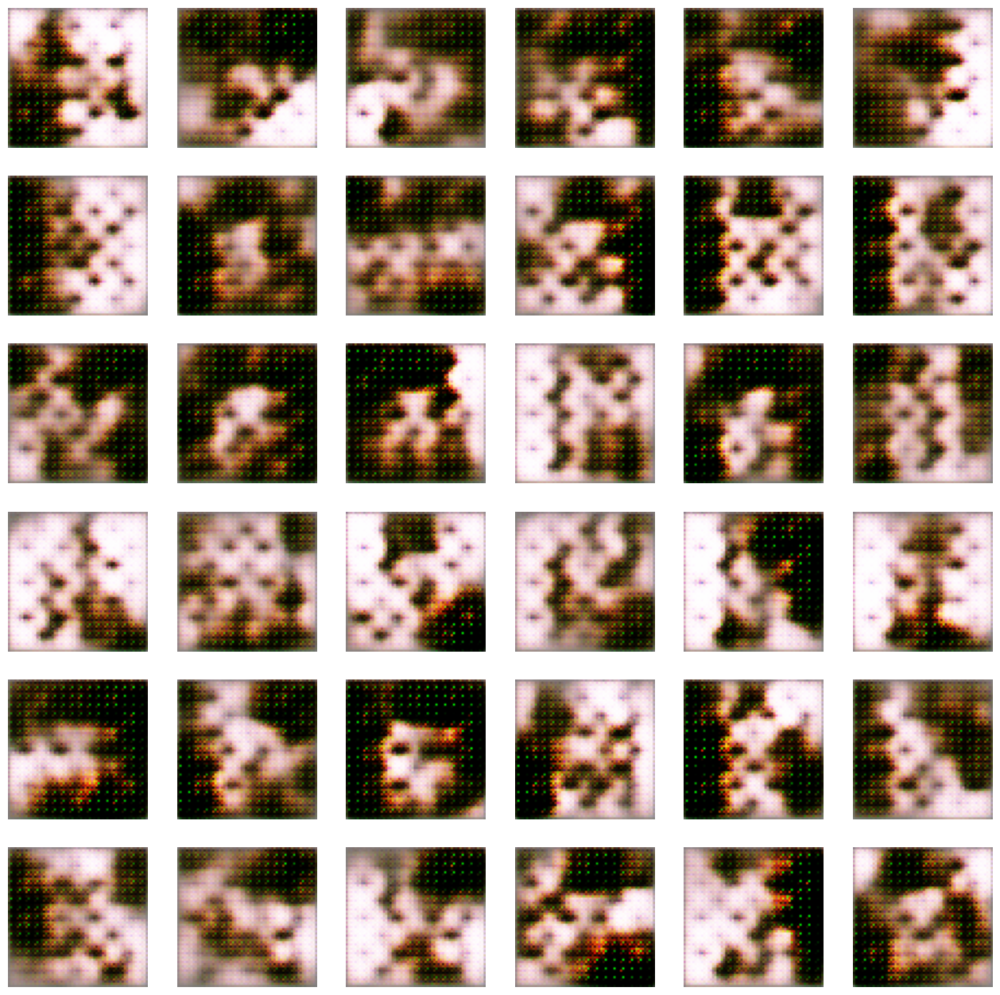

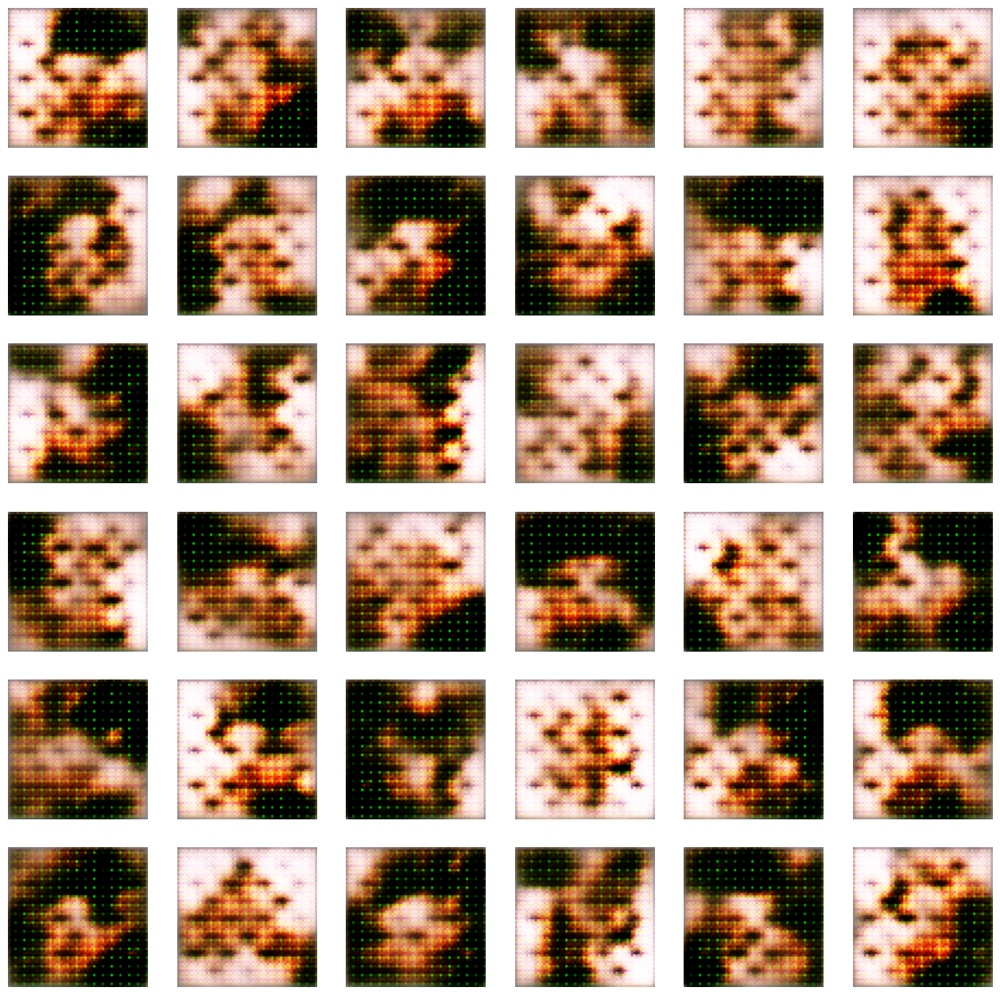

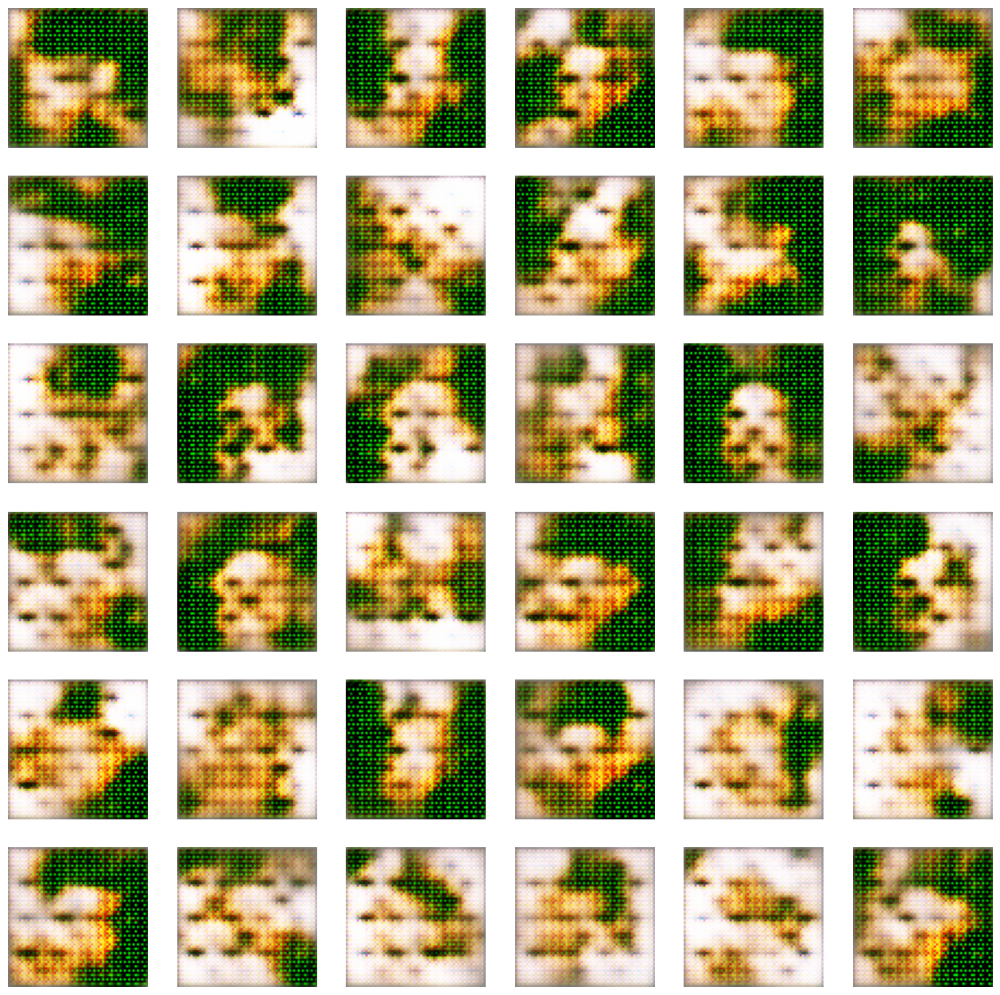

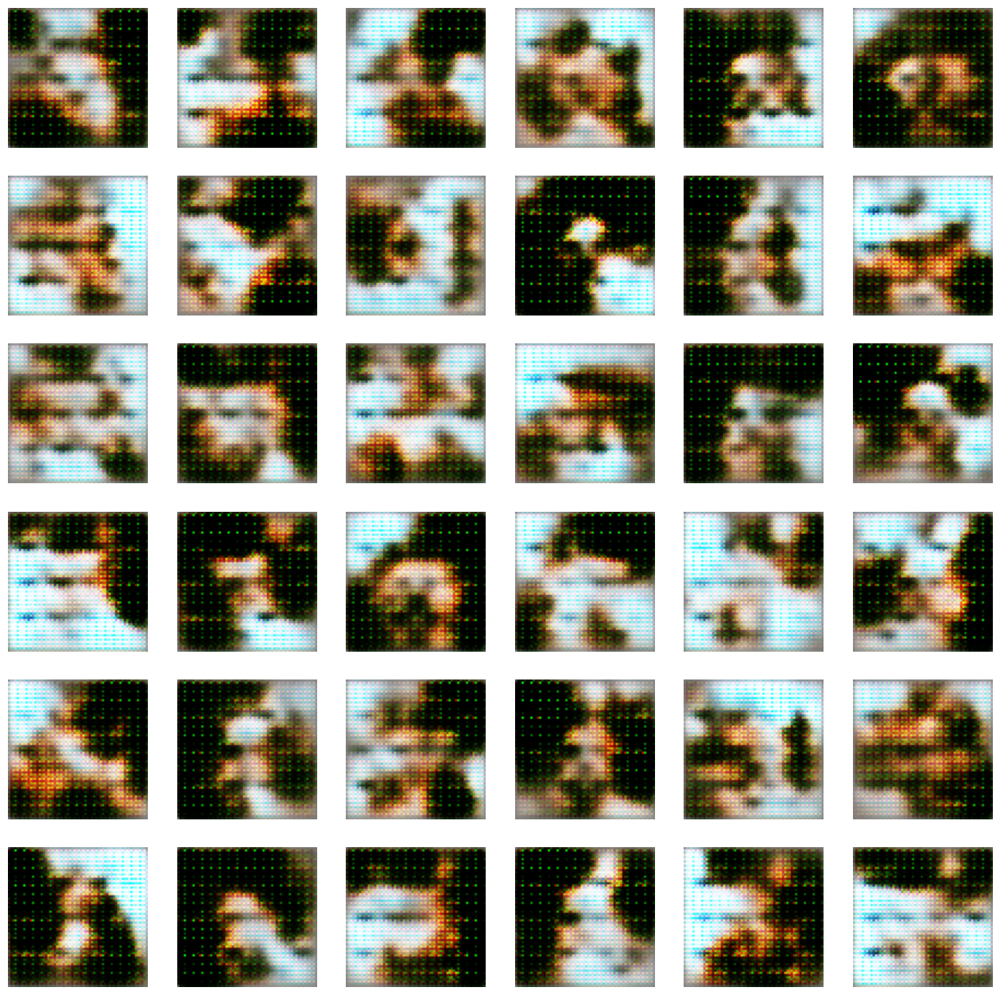

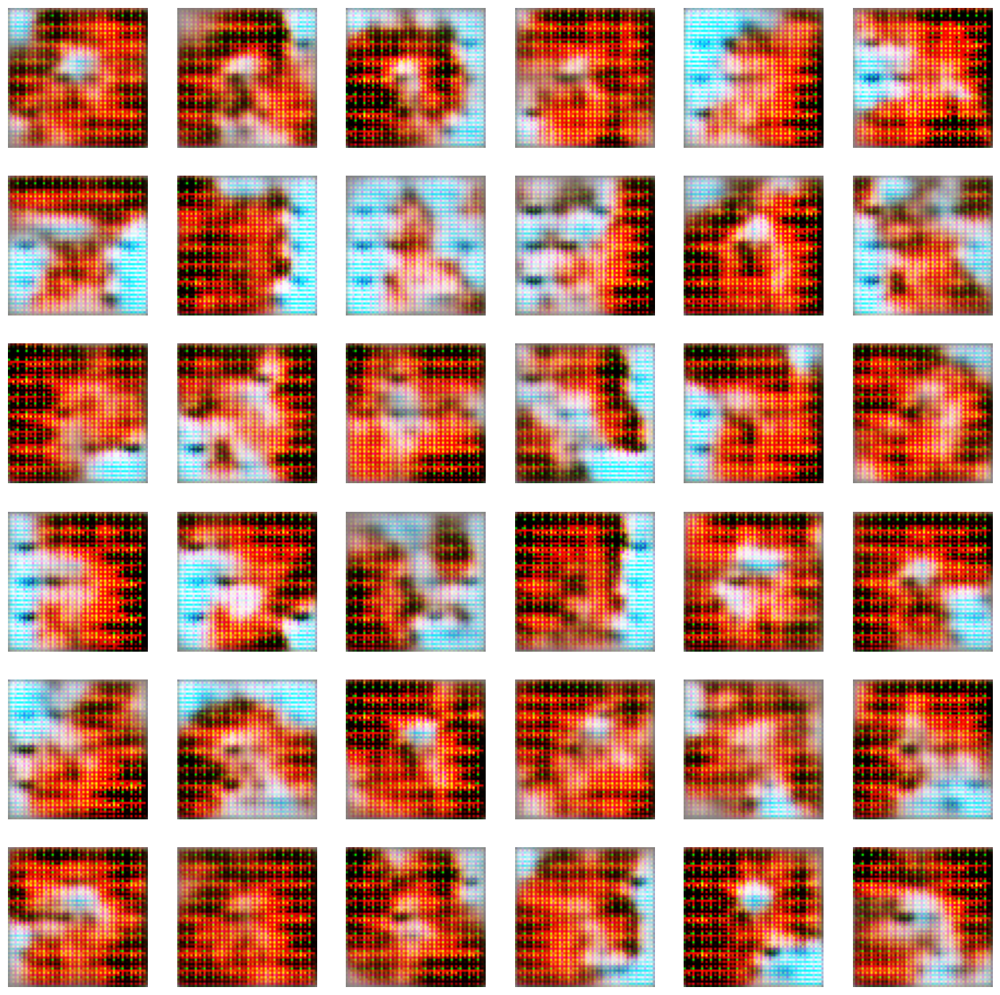

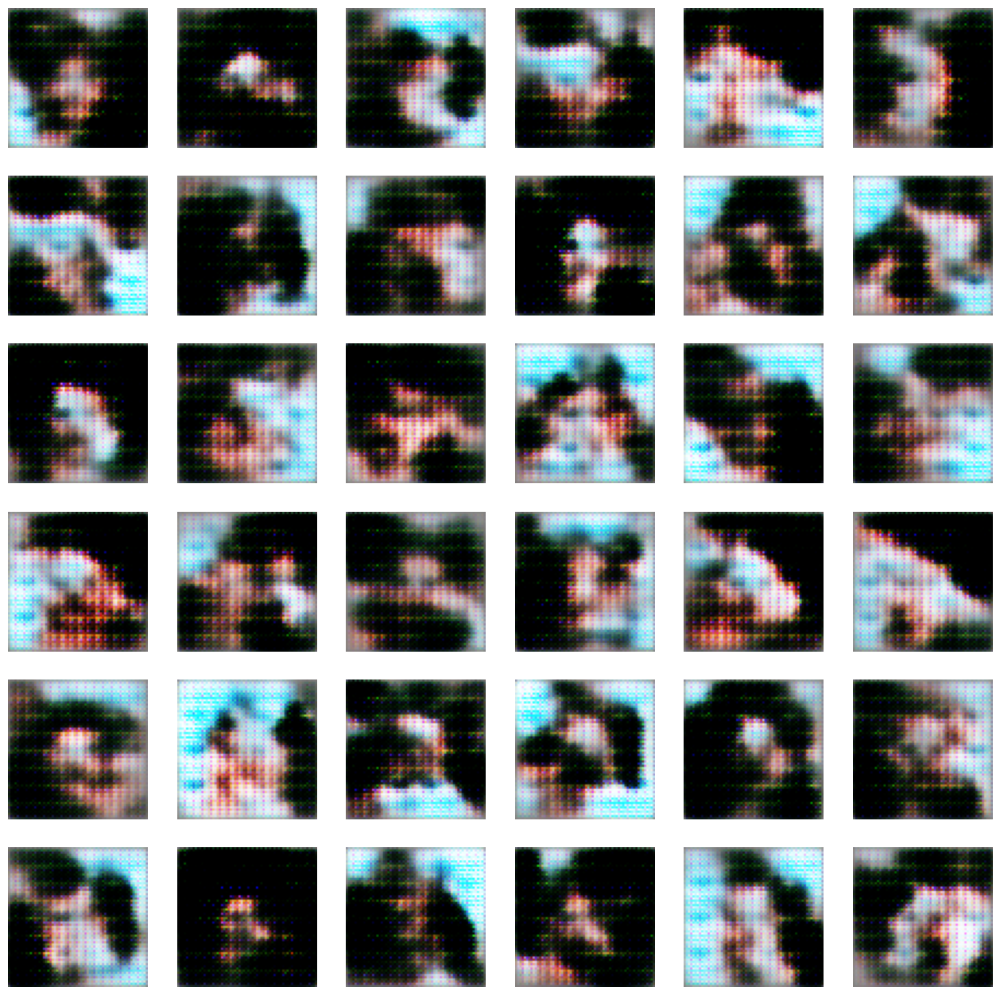

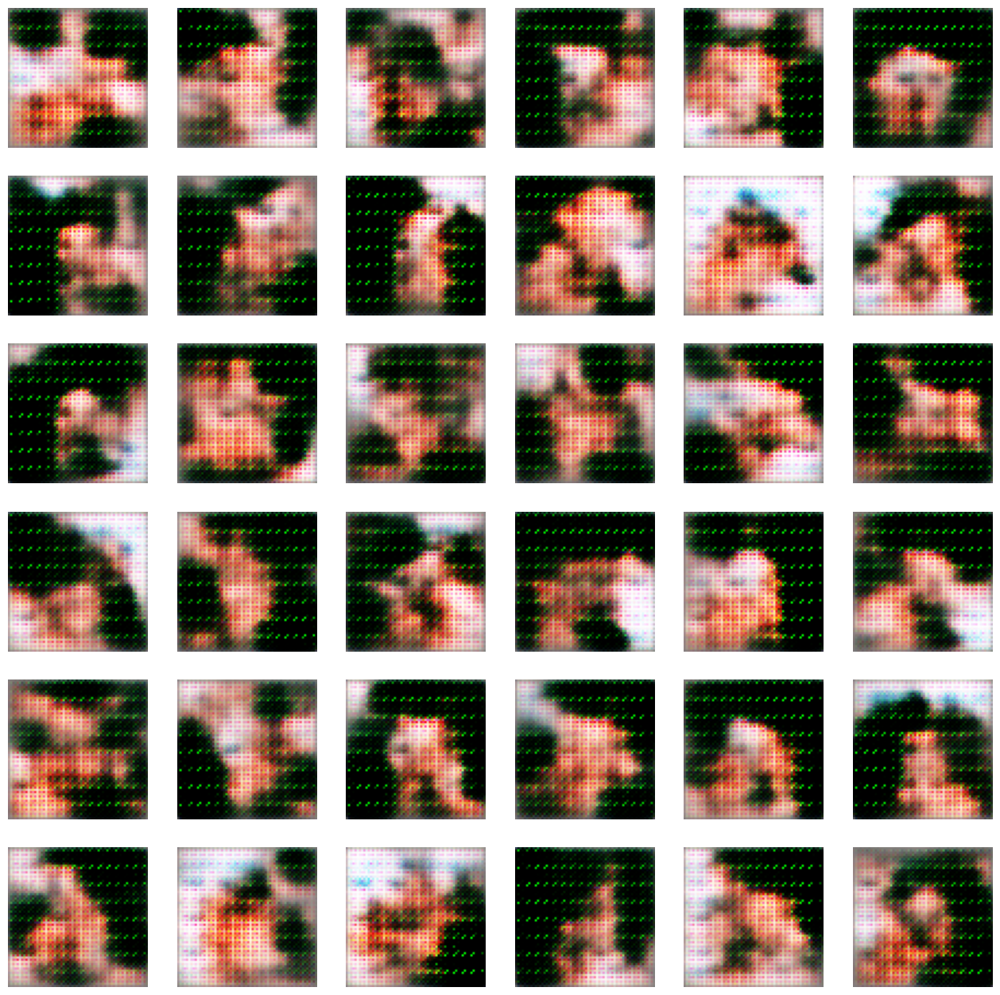

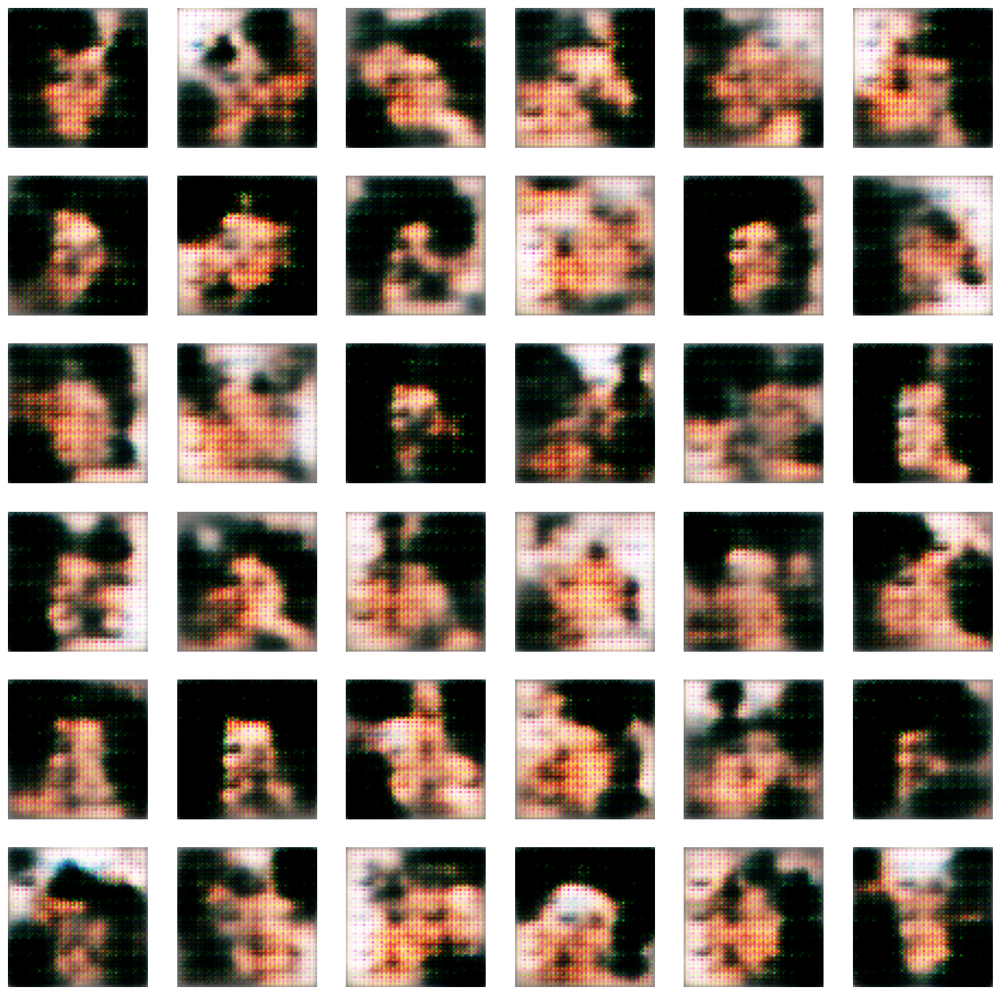

In [20]:
"""
NOTE: I mean, the number of steps is "Unknown" at the first epoch, so that's
expected to happen, isn't it? So based on that, using .repeat() would create
an infinite loop or something as bad as that? Also, because of that, it's advisable
not to train for only one epoch.
->
7/Unknown 99s 13s/step - d_loss: 1.2620 - g_loss: 0.6799
->
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data;
interrupting training. Make sure that your dataset or generator can generate at
least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()`
function when building your dataset.self.gen.throw(typ, value, traceback)
"""
dcgan.fit(train_dataset, epochs=10, verbose=1, callbacks=[ShowImage(latent_dim=100)])
# dcgan.fit(train_dataset, epochs=1, verbose=1) # Not a good idead since the first epoch has number of steps Unknown